# VAE test

## Simple fc test

### Imports

In [1]:
import sys
sys.executable
import torch
import torch.nn as nn
import torch.optim as optim

### Model def

#### TCN

In [2]:
from torch.nn.utils import weight_norm
import torch.nn.functional as F
class TCNBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, dilation, dropout,active = True):
        super(TCNBlock, self).__init__()
        self.conv = weight_norm(nn.Conv1d(in_channels, out_channels, kernel_size= kernel_size, stride=stride, dilation=dilation))
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout)
        self.left_padding = (kernel_size - 1) * dilation
        self.active = active
        self.init_weights()
    
    def init_weights(self) -> None:
        self.conv.weight.data.normal_(0, 0.01)
        
    def forward(self, x):
        x = F.pad(x, (self.left_padding, 0),"constant", 0)
        x = self.conv(x)
        x = self.relu(x) if self.active else x
        x = self.dropout(x)
        return x

In [3]:
class TCN_residual_block(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, dilation, dropout,last = False):
        super(TCN_residual_block, self).__init__()
        self.tcn1 = TCNBlock(in_channels, out_channels, kernel_size, stride, dilation, dropout)
        active = True if not last else False
        self.tcn2 = TCNBlock(out_channels, out_channels, kernel_size, stride, dilation, dropout,active = active)
        self.downsample = nn.Conv1d(in_channels, out_channels, 1) if in_channels != out_channels else None # we can't do it for the first block
        #self.relu = nn.ReLU()
        self.init_weights()
    
    def init_weights(self) -> None:
        if self.downsample is not None:
            self.downsample.weight.data.normal_(0, 0.01)
        
    def forward(self, x):
        residual = x
        out = self.tcn1(x)
        out = self.tcn2(out)
        if self.downsample:
            residual = self.downsample(residual)
        out = out + residual
        #out = self.relu(out)
        return out

In [35]:
class TCN(nn.Module):
    def __init__(self,initial_channels,latent_channels,out_channels,kernel_size,stride,dilatation,dropout,nb_blocks):
        super(TCN,self).__init__()
        self.first_block = TCN_residual_block(initial_channels,latent_channels,kernel_size,stride,dilatation**0,dropout)
        self.layers = [TCN_residual_block(latent_channels,latent_channels,kernel_size,stride,dilatation**(index+1),dropout) for index in range(nb_blocks-2)]
        self.blocks = nn.Sequential(*self.layers)
        self.last_block = TCN_residual_block(latent_channels,out_channels,kernel_size,stride,dilatation**(nb_blocks-1),dropout,last = True)
    def forward(self,x):
        x = self.first_block(x)
        x = self.blocks(x)
        x = self.last_block(x)
        return x


#### TCN encoder

In [36]:
class TCN_encoder(nn.Module):
    def __init__(self,inital_channels,latent_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,avgpoolnum):
        super(TCN_encoder,self).__init__()
        self.tcn = TCN(inital_channels,latent_channels,latent_channels,kernel_size,stride,dilatation,dropout,nb_blocks)
        self.avgpool = nn.AvgPool1d(avgpoolnum)
        self.first_dense_dim = latent_channels*200//avgpoolnum
        #self.first_dense = nn.Linear(self.first_dense_dim,latent_dim)
        self.mu_dense = nn.Linear(self.first_dense_dim,latent_dim)
        self.logvar_dense = nn.Linear(self.first_dense_dim,latent_dim)
        #self.regularize = nn.Hardtanh(min_val=-6.0, max_val=2.0)
        self.flaten = nn.Flatten()
        
    def forward(self,x):
        x = self.tcn(x)
        x = self.avgpool(x)
        #x = x.view(x.size(0), -1)
        x = self.flaten(x)
        #x = self.first_dense(x)
        
        
        mu = self.mu_dense(x)
        logvar = self.logvar_dense(x)
        #logvar = self.regularize(logvar)
        return mu,logvar
        

In [37]:
class TCN_decoder(nn.Module):
    def __init__(self,in_channels,out_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,upsamplenum):
        super(TCN_decoder,self).__init__()
        self.first_dense = nn.Linear(latent_dim,in_channels*(200//upsamplenum))
        self.upsample = nn.Upsample(scale_factor=upsamplenum)
        self.tcn = TCN(in_channels,latent_dim,out_channels,kernel_size,stride,dilatation,dropout,nb_blocks)
        self.sampling_factor = upsamplenum
        
    def forward(self,x):
        x = self.first_dense(x)
        b, _ = x.size()
        x = x.view(b, -1, int(200 / self.sampling_factor))
        x = self.upsample(x)
        x = self.tcn(x)
        return x

In [38]:
class VAE_TCN(nn.Module):
    def __init__(self,in_channels,out_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,avgpoolnum,upsamplenum):
        super(VAE_TCN,self).__init__()
        self.encoder = TCN_encoder(in_channels,out_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,avgpoolnum)
        self.decoder = TCN_decoder(latent_dim,in_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,upsamplenum)
        self.scale = nn.Parameter(
            torch.Tensor([1]), requires_grad=True
        )
    
    def encode(self,x):
        mu,logvar = self.encoder(x)
        return mu,logvar

    def decode(self,z):
        x = self.decoder(z)
        return x

    def reparameterize(self,mu,logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
    
    def forward(self,x):
        mu,logvar = self.encode(x)
        z = self.reparameterize(mu,logvar)
        x_reconstructed = self.decode(z)
        return x_reconstructed,mu,logvar
    
    
    

#### Encodeur FCL

In [118]:
class VAE_encoder_FCL(nn.Module):
    def __init__(self,input_dim,hidden_dim_1,hidden_dim_2,latent_dim,dropout_prob =0):
        super(VAE_encoder_FCL,self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(input_dim,hidden_dim_1),
            nn.ReLU(),
            #nn.BatchNorm1d(hidden_dim_1),
            nn.Dropout(dropout_prob),
            nn.Linear(hidden_dim_1,hidden_dim_2),
            nn.ReLU(),
            #nn.BatchNorm1d(hidden_dim_2),
            nn.Dropout(dropout_prob),
            nn.Linear(hidden_dim_2,latent_dim*2)
        )

    def forward(self,x):
        result = self.layers(x)
        mu, log_var = torch.chunk(result, 2, dim=-1)  # Split into mean and log variance
        return mu, log_var

#### Decodeur FCL

In [119]:
#same as encoder but reversed
class VAE_decoder_FCL(nn.Module):
    def __init__(self,output_dim,hidden_dim_1,hidden_dim_2,latent_dim,dropout_prob =0):
        super(VAE_decoder_FCL,self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(latent_dim,hidden_dim_2),
            nn.ReLU(),
           # nn.BatchNorm1d(hidden_dim_2),
            nn.Dropout(dropout_prob),
            nn.Linear(hidden_dim_2,hidden_dim_1),
            nn.ReLU(),
            #nn.BatchNorm1d(hidden_dim_1),
            nn.Dropout(dropout_prob),
            nn.Linear(hidden_dim_1,output_dim)
        )

    def forward(self,x):
        result = self.layers(x)
        return result

#### FCL VAE

In [122]:

# Define the VAE model
class VAE_FCL(nn.Module):
    def __init__(self, input_dim, hidden_dim_1,hidden_dim_2, latent_dim):
        super(VAE_FCL, self).__init__()
        
        # Encoder: Maps input to latent space (mean and log variance)
        self.encoder = VAE_encoder_FCL(input_dim,hidden_dim_1,hidden_dim_2,latent_dim)
        
        # Decoder: Maps latent space back to input space
        self.decoder = VAE_decoder_FCL(input_dim,hidden_dim_1,hidden_dim_2,latent_dim)
        self.scale = nn.Parameter(
            torch.Tensor([1]), requires_grad=True
        )

    def encode(self, x):
        return self.encoder(x)

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)  # Convert log variance to standard deviation
        eps = torch.randn_like(std)  # Sample from standard normal distribution
        return mu + eps * std  # Apply reparameterization trick

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        x = x.view(x.size(0), -1)
        #print(x.shape)
        mu, log_var = self.encode(x)
        z = self.reparameterize(mu, log_var)
        x_recon = self.decode(z)
        return x_recon.view(x.size(0), 200, 4), mu, log_var


### VampPrior 

In [ ]:
 #VampPrior Pseudo inputs generator
class Pseudo_inputs_generator(nn.Module):
    def __init__(self,number_of_channels,number_of_points, pseudo_inputs_num):
        super(Pseudo_inputs_generator, self).__init__()
        self.number_of_channels = number_of_channels
        self.number_of_points = number_of_points
        self.pseudo_inputs_num = pseudo_inputs_num
        self.first_layer = nn.Linear(pseudo_inputs_num, pseudo_inputs_num)
        self.relu = nn.ReLU()
        self.second_layer = nn.Linear(pseudo_inputs_num, number_of_channels*number_of_points)
    def forward(self):
        x = torch.autograd.Variable(torch.eye(self.pseudo_inputs_num, self.pseudo_inputs_num), requires_grad=False )
        pseudo_inputs = self.first_layer(x)
        pseudo_inputs = self.relu(pseudo_inputs)
        pseudo_inputs = self.second_layer(pseudo_inputs)
        return pseudo_inputs
    

        

In [ ]:
class VampPrior_VAE_TCN(nn.Module):
    def __init__(self,in_channels,out_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,avgpoolnum,upsamplenum,pseudo_inputs_num):
        super(VAE_TCN,self).__init__()
        self.encoder = TCN_encoder(in_channels,out_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,avgpoolnum)
        self.decoder = TCN_decoder(latent_dim,in_channels,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,upsamplenum)
        self.pseudo_input_gen = Pseudo_inputs_generator(latent_dim,200,pseudo_inputs_num)

    def encode(self,x):
        mu,logvar = self.encoder(x)
        return mu,logvar

    def decode(self,z):
        x = self.decoder(z)
        return x
    
    def get_pseudo_inputs_distribution(self):
        pseudo_inputs = self.pseudo_input_gen.forward()
        mu,logvar = self.encoder(pseudo_inputs)
        return mu,logvar
    
    def reparameterize(self,mu,logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
    
    def forward(self,x):
        mu_pseudo,logvar_pseudo = self.get_pseudo_inputs_distribution()
        mu,logvar = self.encode(x)
        z = self.reparameterize(mu,logvar)
        x_reconstructed = self.decode(z)
        return x_reconstructed,mu,logvar,mu_pseudo,logvar_pseudo

In [ ]:
def VAE_Vamp_prior_loss()

## Get the data

### Imports

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from tqdm.autonotebook import tqdm 
from traffic.core import Traffic

/tmp/ipykernel_1542467/265353039.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [9]:
%matplotlib inline

In [10]:
from cartes.crs import Lambert93
from traffic.data import airports

### Reading the data

In [11]:
landings_orly_6 = Traffic.from_file("landings_LFPO_06.pkl")

In [12]:
# Sanity check
len(landings_orly_6)

7753

In [13]:
#getting the mean point to rebuild trajectories
total_lat = 0
total_long = 0
for flight in landings_orly_6:
    lat_f =flight.data.iloc[-1]['latitude']
    long_f = flight.data.iloc[-1]['longitude']

    total_lat += lat_f
    total_long +=long_f
    #print(f'({lat_f},{long_f})')

mean_point = (total_lat/len(landings_orly_6),total_long/len(landings_orly_6))
print(mean_point)
    

(48.704496559124955, 2.2733392424026833)


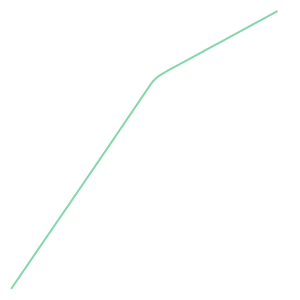

In [14]:
landings_orly_6[0]

### Plotting the data

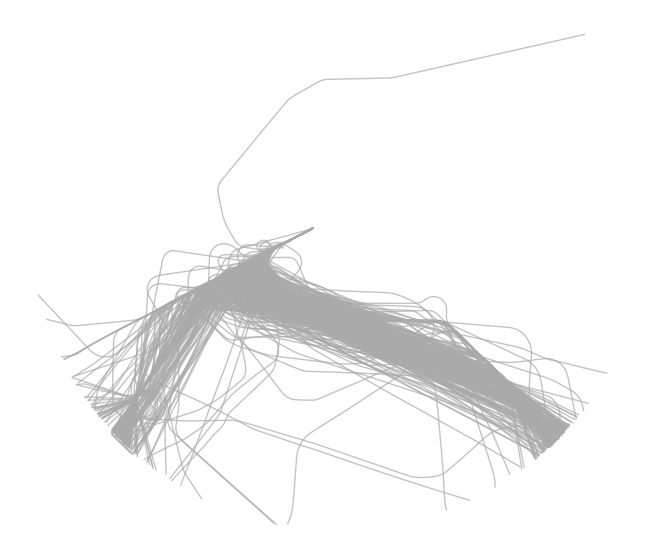

In [15]:
with plt.style.context("traffic"):
    fig, ax = plt.subplots(subplot_kw=dict(projection=Lambert93()))
    landings_orly_6[:1000].plot(ax, alpha=.7)

### Rebuilding data from track and groundspeed

In [16]:
import numpy as np
#allows to infer the lat and the long from a trajectory using track, groundspeed and the final position of the trajectory
def fast_infer_lat_lon_faster(trajectory, final_position):
    """
    Faster inference of latitude and longitude for a trajectory using small-angle approximations.
    
    Parameters:
        trajectory: List of dicts, each with 'ground_speed' (m/s), 'track' (degrees), 
                    'altitude' (m), 'time' (s) since beginning.
        final_position: Tuple (latitude, longitude) of the final known position.
    
    Returns:
        List of (latitude, longitude) for each point in the trajectory.
    """
    R = 6378137  # Earth radius in meters
    #R = 6371000
    lat, lon = np.radians(final_position)  # Convert to radians
    inferred_positions = [(lat, lon)]

    times = np.array([p.timedelta for p in trajectory.itertuples()])
    speeds = np.array([p.groundspeed *0.514444  for p in trajectory.itertuples()])
    tracks = np.radians(np.array([p.track for p in trajectory.itertuples()]))  # Convert to radians
    
    # Compute time differences
    dt = np.diff(times, append=times[-1])

    # Compute traveled distances
    distances = speeds * dt  # meters

    # Compute small-step displacements
    d_lat = (distances / R) * np.cos(tracks)  # Latitude change
    d_lon = (distances / (R * np.cos(lat))) * np.sin(tracks)  # Longitude change

    # Reverse integrate the trajectory
    for i in range(len(trajectory) - 2, -1, -1):
        lat -= d_lat[i]
        lon -= d_lon[i]
        inferred_positions.append((lat, lon))

    # Convert back to degrees
    return [(np.degrees(lat), np.degrees(lon)) for lat, lon in inferred_positions[::-1]]


In [17]:
#Rebuild a traffic where flights lacks latitude and longitude, using groundspeed,tracks and a commun end-point for all trajectories
def rebuild_traffic(traff,point_mean):
    new_traff = pd.DataFrame()
    new_traff = []
    i =0
    tot = len(traff)
    for flight in traff:
        print(f"{i}/{tot}")
        i+=1
        flight_data = flight.data
        reconstructed_traj = fast_infer_lat_lon_faster(flight_data,point_mean)
        flight_data["latitude"] = [elem for elem,_ in reconstructed_traj]
        flight_data["longitude"] = [elem for _,elem in reconstructed_traj]
        new_traff.append(flight_data.values)
    new_traff = np.vstack(new_traff)
    result = pd.DataFrame(new_traff, columns=traff.data.columns.tolist() + ["latitude","longitude"])    
    return Traffic(result)

#### Testing

In [18]:
#We delete the latitude and the longitude
data_test = landings_orly_6.data
data_test_no_pos = data_test.drop(['latitude', 'longitude'], axis=1) 

In [19]:
new_traf = Traffic(data_test_no_pos)

In [20]:
#Test of the rebuild function
#rebuilded = rebuild_traffic(new_traf,mean_point)

In [21]:
# with plt.style.context("traffic"):
#     fig, ax = plt.subplots(1,2,subplot_kw=dict(projection=Lambert93()))
#     rebuilded[:500].plot(ax[0], alpha=.7)
#     landings_orly_6[:500].plot(ax[1], alpha=.7)

The two computed traffics seem well reconsturcted. There seems to be some artefacts, liekely du to the averaging of the endpoint of the trajectories

### Data processing

In [22]:
landings_orly_6[0].data.head()

,timestamp,altitude,callsign,groundspeed,icao24,latitude,longitude,origin,squawk,track,vertical_rate,flight_id,distance,track_unwrapped,x,y,timedelta
0,2022-07-27 20:47:50+00:00,11100.0,17LQ,375.0,3453c3,48.158243,1.486323,LPPT,1162,34.028841,-1600.0,17LQ_000,47.315521,34.028841,-58618.219509,5361355.06863,0
1,2022-07-27 20:47:54+00:00,11100.0,17LQ,374.0,3453c3,48.164202,1.492406,LPPT,1162,34.159695,-1600.0,17LQ_000,46.888796,34.159695,-58101.331146,5361972.360065,4
2,2022-07-27 20:47:56+00:00,11100.0,17LQ,374.0,3453c3,48.167088,1.495297,LPPT,1162,34.159695,-1600.0,17LQ_000,46.6837,34.159695,-57855.090588,5362271.775864,6
3,2022-07-27 20:48:00+00:00,11100.0,17LQ,372.0,3453c3,48.17244,1.500761,LPPT,1162,34.159695,-1408.0,17LQ_000,46.30064,34.159695,-57390.944327,5362826.172853,10
4,2022-07-27 20:48:04+00:00,11100.0,17LQ,371.0,3453c3,48.178354,1.506789,LPPT,1162,34.118599,-1088.0,17LQ_000,45.877677,34.118599,-56878.765677,5363439.034793,14


In [23]:
from torch.utils.data.dataloader import default_collate
from torch.utils.data import TensorDataset, DataLoader

def preprocess_data(traffic: Traffic,batch_size = 500):
    flights = []
    for flight in traffic:
        data = flight.data
        data = data[["track","altitude","groundspeed","timedelta"]]
        #og_time = data["timestamp"][0]
        #data["timestamp"] = data["timestamp"] - og_time
        np_data = data.to_numpy()
        #np_data[:,-1] = np.array([timediff.total_seconds() for timediff in np_data[:,-1]])
        flights.append(np_data)

    #create data loader
    trajectories = np.stack(flights).astype(np.float32)
    trajectories_tensor = torch.tensor(trajectories, dtype=torch.float32)  # Shape: (100, 200, 4)
   
   
    

    # Compute min and max per feature
    x_min = trajectories_tensor.amin(dim=(0,1), keepdim=True)[0]
    x_max = trajectories_tensor.amax(dim=(0,1), keepdim=True)[0]

    # Normalize between -1 and 1 per feature
    normalized_tensor = 2 * (trajectories_tensor - x_min) / (x_max - x_min) - 1

    # Create dataset with normalized data
    dataset = TensorDataset(normalized_tensor)

    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, collate_fn=None)

    return dataloader,x_min,x_max

In [24]:
dataloader,x_min,x_max = preprocess_data(landings_orly_6,500)

In [25]:
#sanity check
print(x_min)

tensor([[  0., 425.,  94.,   0.]])


In [26]:
#denromalizing teh ouputs
def denormalize(x_normalized, x_min, x_max):
    return ((x_normalized + 1) / 2) * (x_max - x_min) + x_min



## Train the model

### Training 

In [103]:
def gaussian_likelihood_learned_variance(x, x_reco, scale, epsilon=1e-6):
    """
    Compute the Gaussian log-likelihood with a learned variance.

    Args:
        x (Tensor): True data.
        x_reco (Tensor): Reconstructed mean.
        scale (Tensor): Logarithm of the standard deviation.
        epsilon (float): Small value added for numerical stability.

    Returns:
        Tensor: Negative log-likelihood loss.
    """

    mean = x_reco
    stddev = torch.exp(scale) + epsilon
    dist = torch.distributions.Normal(mean, stddev)
        # measure prob of seeing trajectory under p(x|z)
    log_pxz = dist.log_prob(x)
    #print(log_pxz.size())
    dims = [i for i in range(1, len(x.size()))]
    log_like =  -log_pxz.sum(dims)  # Minimize negative log-likelihood

    # sigma = torch.exp(scale) + epsilon  # Ensure positive variance and numerical stability
    # log_likelihood = -0.5 * ((x - x_reco) ** 2 / sigma**2) - scale - 0.5 * torch.log(torch.tensor(2 * torch.pi, device=x.device))
    # dims = [i for i in range(1, len(x.size()))]
    # print(log_likelihood.sum(dims),log_like)
    return log_like  # Minimize negative log-likelihood

def corrected_vae_loss(x, x_recon, mu, logvar, scale, beta=1):
    # Compute reconstruction loss
    recon_loss = gaussian_likelihood_learned_variance(x, x_recon, scale)
    # Compute KL divergence
    batch_size = x.size(0)
    kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())/batch_size
    #print(kl_loss)
    return recon_loss.mean() + beta*kl_loss


In [102]:
def gaussian_likelihood_learned_variance(x, x_reco, scale):
    """
    Compute the Gaussian log-likelihood with a learned variance.

    Args:
        x (Tensor): True data.
        mu (Tensor): Reconstructed mean.
        log_sigma (Tensor): Logarithm of the standard deviation.

    Returns:
        Tensor: Negative log-likelihood loss.
    """

    

    sigma = torch.exp(scale)  # Ensure positive variance
    #print(sigma.size(),x.size(),x_reco.size())
    log_likelihood = -0.5 * ((x - x_reco) ** 2 / sigma**2) - scale - 0.5 * torch.log(torch.tensor(2 * torch.pi, device=x.device))
    print(log_likelihood.sum(dims),log_like.sum(dims)) 
    return -log_likelihood.sum(dims)  # Minimize negative log-likelihood


In [85]:
def corrected_vae_loss(x,x_recon,mu,logvar,scale,beta = 1):
    # Compute reconstruction loss
    recon_loss = gaussian_likelihood_learned_variance(x, x_recon, scale)
    # Compute KL divergence
    kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return (recon_loss + beta*kl_loss).mean()

In [29]:
import torch.nn.functional as F
def vae_loss(x, x_recon, mu, log_var,beta = 1):
    recon_loss = F.mse_loss(x_recon, x, reduction='sum') / x.shape[0]  # Reconstruction loss
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())  # KL divergence
    return recon_loss +  beta*kl_div / x.shape[0]  # Average over batch

In [30]:
def vae_loss_see(x, x_recon, mu, log_var,beta =1):
    recon_loss =  F.mse_loss(x_recon, x, reduction='sum') / x.shape[0]  # Reconstruction loss
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())  # KL divergence
    return recon_loss,  beta*kl_div / x.shape[0]  # Average over batch

In [86]:
from torch.optim.lr_scheduler import StepLR
def train_model(model,data_loader,num_epoch,step_size,gamma,beta,device,learning_rate = 0.001,tcn:bool = False):

    #criterion = vae_loss
    criterion = corrected_vae_loss  
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)

    for epoch in range(num_epoch):
        model.train()  
        running_loss = 0.0
        total_kl = 0.0
        total_reco = 0.0

        for batch in dataloader:  
            inputs = batch[0].to(device) 
            
            #print(inputs.shape) # 500 200 4
             
            optimizer.zero_grad()
            if tcn :
                inputs = inputs.permute(0,2,1)
            # Forward pass
            x_out,mu,log_var = model(inputs)
            #print(log_var)
            #print(x_out.shape)

            #print(inputs.shape)
            #print(x_out.shape)
            # Compute the loss
            loss = criterion(inputs,x_out, mu,log_var,model.scale,beta)

            # Backward pass (compute gradients)
            loss.backward()
            recon,kl = vae_loss_see(inputs,x_out,mu,log_var,beta)
            # Optimize the model parameters
            optimizer.step()

            # Accumulate loss for reporting
            running_loss += loss.item()
            total_kl += kl
            total_reco += recon

        scheduler.step()
        # Print average loss for this epoch
        avg_loss = running_loss / len(dataloader)
        total_kl /= len(dataloader)
        total_reco /= len(dataloader)
        print(f"Epoch {epoch+1}/{num_epoch}, Loss: {avg_loss:.4f}, kl = {total_kl:.4f}, recon = {total_reco:.4f}")
    return model

In [123]:
#Vae fcl train and param
input_dim = 200*4
hidden_dim_1 = 218
hidden_dim_2 = 128
latent_dim = 32

gamma = 0.5
step_size = 200
beta = 1

num_epoch = 500

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model = VAE_FCL(input_dim,hidden_dim_1,hidden_dim_2,latent_dim).to(device)

trained = train_model(model,dataloader,num_epoch,step_size,gamma,beta,device)

Using device: cuda
Epoch 1/500, Loss: 1541.0156, kl = 0.1020, recon = 171.8870
Epoch 2/500, Loss: 1522.9259, kl = 0.1052, recon = 92.0347
Epoch 3/500, Loss: 1509.6071, kl = 0.2312, recon = 81.2526
Epoch 4/500, Loss: 1495.2420, kl = 1.0081, recon = 48.6974
Epoch 5/500, Loss: 1481.6337, kl = 1.2340, recon = 35.0673
Epoch 6/500, Loss: 1468.5393, kl = 1.2717, recon = 31.0748
Epoch 7/500, Loss: 1455.5452, kl = 1.3227, recon = 28.2700
Epoch 8/500, Loss: 1442.5935, kl = 1.3531, recon = 26.2301
Epoch 9/500, Loss: 1429.6014, kl = 1.3647, recon = 23.9587
Epoch 10/500, Loss: 1416.5974, kl = 1.3620, recon = 21.7765
Epoch 11/500, Loss: 1403.6534, kl = 1.3396, recon = 20.4985
Epoch 12/500, Loss: 1390.7415, kl = 1.3536, recon = 19.1945
Epoch 13/500, Loss: 1377.8094, kl = 1.3064, recon = 18.3189
Epoch 14/500, Loss: 1364.9889, kl = 1.3559, recon = 17.5847
Epoch 15/500, Loss: 1352.1123, kl = 1.3296, recon = 17.0264
Epoch 16/500, Loss: 1339.2529, kl = 1.3266, recon = 16.3940
Epoch 17/500, Loss: 1326.3690

In [104]:
#VAE TCN train and param

input_dim = 4
hidden_dim = 64
latent_dim = 64
kernel_size = 16
stride = 1
dropout = 0
dilatation = 2
nb_blocks = 4
sampling_factor = 10

gamma = 0.5
step_size = 200
beta = 1
learning_rate = 0.001
num_epoch = 500

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model_tcn = VAE_TCN(input_dim,hidden_dim,latent_dim,kernel_size,stride,dilatation,dropout,nb_blocks,sampling_factor,sampling_factor).to(device)
model_tcn_trained = train_model(model_tcn,dataloader,num_epoch,step_size,gamma,beta,device,learning_rate = learning_rate,tcn= True)


Using device: cuda


/home/arnault/traffic/.venv/lib/python3.10/site-packages/torch/nn/utils/weight_norm.py:143: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


Epoch 1/500, Loss: 1540.1034, kl = 0.5936, recon = 151.2360
Epoch 2/500, Loss: 1523.5338, kl = 0.1188, recon = 100.1656
Epoch 3/500, Loss: 1509.6177, kl = 0.4734, recon = 77.5911
Epoch 4/500, Loss: 1495.0394, kl = 1.1796, recon = 43.1158
Epoch 5/500, Loss: 1481.6023, kl = 1.1964, recon = 34.5423
Epoch 6/500, Loss: 1468.5454, kl = 1.2962, recon = 30.1896
Epoch 7/500, Loss: 1455.4915, kl = 1.3410, recon = 26.6962
Epoch 8/500, Loss: 1442.6715, kl = 1.4055, recon = 25.7854
Epoch 9/500, Loss: 1429.6253, kl = 1.3641, recon = 23.4557
Epoch 10/500, Loss: 1416.6401, kl = 1.3643, recon = 21.4128
Epoch 11/500, Loss: 1403.4984, kl = 1.2399, recon = 19.0966
Epoch 12/500, Loss: 1390.3335, kl = 1.1001, recon = 16.8050
Epoch 13/500, Loss: 1377.3762, kl = 1.0526, recon = 15.7690
Epoch 14/500, Loss: 1364.5509, kl = 1.0788, recon = 15.3071
Epoch 15/500, Loss: 1351.7244, kl = 1.0712, recon = 15.1259
Epoch 16/500, Loss: 1338.8805, kl = 1.0603, recon = 14.7730
Epoch 17/500, Loss: 1326.0829, kl = 1.0689, rec

In [81]:
model_tcn.scale

Parameter containing:
tensor([0.8778], device='cuda:0', requires_grad=True)

In [ ]:


# Assuming 'optimizer' is your Adam optimizer


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model = VAE_FCL(input_dim,hidden_dim_1,hidden_dim_2,latent_dim).to(device)

criterion = vae_loss  # Or use nn.CrossEntropyLoss() for classification tasks
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)

for epoch in range(num_epoch):
    model.train()  # Set the model to training mode
    running_loss = 0.0
    total_kl = 0.0
    total_reco = 0.0

    for batch in dataloader:  # Assuming train_loader is already defined
        inputs = batch[0].to(device) # Get input features
        
        #print(inputs.shape) # 500 200 4
       
        optimizer.zero_grad()

        # Forward pass
        x_out,mu,log_var = model(inputs)
        #print(log_var)
        #print(x_out.shape)



        loss = criterion(inputs,x_out, mu,log_var,beta)

        # Backward pass (compute gradients)
        loss.backward()
        recon,kl = vae_loss_see(inputs,x_out,mu,log_var,beta)

        optimizer.step()

        # Accumulate loss for reporting
        running_loss += loss.item()
        total_kl += kl
        total_reco += recon

    scheduler.step()
    # Print average loss for this epoch
    avg_loss = running_loss / len(dataloader)
    total_kl /= len(dataloader)
    total_reco /= len(dataloader)
    print(f"Epoch {epoch+1}/{num_epoch}, Loss: {avg_loss:.4f}, kl = {total_kl:.4f}, recon = {total_reco:.4f}")

Using device: cuda
Epoch 1/1000, Loss: 162.0176, kl = 3.1960, recon = 158.8216
Epoch 2/1000, Loss: 66.3992, kl = 4.2729, recon = 62.1263
Epoch 3/1000, Loss: 30.1313, kl = 6.2920, recon = 23.8394
Epoch 4/1000, Loss: 25.4325, kl = 6.3902, recon = 19.0423
Epoch 5/1000, Loss: 23.5672, kl = 5.7608, recon = 17.8064
Epoch 6/1000, Loss: 22.3126, kl = 5.4330, recon = 16.8796
Epoch 7/1000, Loss: 21.1797, kl = 5.0036, recon = 16.1762
Epoch 8/1000, Loss: 20.0071, kl = 4.6502, recon = 15.3569
Epoch 9/1000, Loss: 18.9726, kl = 4.3218, recon = 14.6508
Epoch 10/1000, Loss: 18.0347, kl = 3.8721, recon = 14.1626
Epoch 11/1000, Loss: 17.5017, kl = 3.7246, recon = 13.7771
Epoch 12/1000, Loss: 17.1568, kl = 3.5747, recon = 13.5820
Epoch 13/1000, Loss: 16.8163, kl = 3.5037, recon = 13.3126
Epoch 14/1000, Loss: 16.5137, kl = 3.4510, recon = 13.0627
Epoch 15/1000, Loss: 16.2871, kl = 3.2935, recon = 12.9936
Epoch 16/1000, Loss: 15.9970, kl = 3.2139, recon = 12.7831
Epoch 17/1000, Loss: 15.8307, kl = 3.1086, r

### TEST with modified just to see

### Generate new trajectories

In [105]:
model = model_tcn_trained

In [124]:

batch_size = 500
z_sample = torch.randn(batch_size, latent_dim).to(device) 
with torch.no_grad():
    generated_data = model.decode(z= z_sample)
print("Generated Data: ", generated_data)


Generated Data:  tensor([[ 0.7651, -0.1224,  0.3283,  ..., -0.9636, -0.7619,  0.0997],
        [-0.7726,  0.0229,  0.2509,  ..., -0.9664, -0.7982, -0.1516],
        [ 0.7330, -0.0720, -0.0709,  ..., -0.9618, -0.7984,  0.4011],
        ...,
        [ 0.7821, -0.1879,  0.4290,  ..., -0.9610, -0.7483,  0.1996],
        [-0.7855, -0.1292, -0.1108,  ..., -0.9797, -0.7846, -0.1769],
        [ 0.2785,  0.0415,  0.2421,  ..., -0.9751, -0.7826,  0.4767]],
       device='cuda:0')


In [107]:
generated_data.shape

torch.Size([500, 4, 200])

In [126]:
from datetime import datetime, timedelta
def interpret_output(output,tcn = False):
    traj = output.view(output.size(0), 200, 4) if not tcn else output.permute(0,2,1)
    
    gen_traj_tensor = denormalize(traj,x_min.to(device),x_max.to(device))
    array = gen_traj_tensor.cpu().numpy().reshape(-1, 4)

   
    final_df_traj = pd.DataFrame(array, columns=["track","altitude","groundspeed","timedelta"])
    print(final_df_traj)
    new_col = [f"{i//200}" for i in range(500*200)][:len(final_df_traj)]
    final_df_traj["icao24"] = new_col
    

   
    final_df_traj["timestamp"] = final_df_traj["timedelta"].apply(
        lambda x: datetime(2020, 2, 1, 12, 0, 0) + timedelta(seconds=x)
    )

    test = Traffic(final_df_traj)
    test = rebuild_traffic(test,mean_point)
    return test


In [127]:
test = interpret_output(generated_data)

            track      altitude  groundspeed    timedelta
0      317.726715  12141.240234   358.993744     8.649040
1      316.514404  12075.149414   358.257111    10.389037
2      316.394867  12081.926758   358.146545    18.705843
3      316.586578  12089.254883   356.849548    18.989624
4      315.198669  12040.642578   354.177032    27.533159
...           ...           ...          ...          ...
99995   59.935741   1035.944214   138.802597  1441.875000
99996   60.639328    965.048584   139.022110  1443.420410
99997   59.515041    844.989258   138.624481  1459.707886
99998   59.936504    911.220337   137.923874  1457.012817
99999   61.710743    757.993774   137.364395  1469.318726

[100000 rows x 4 columns]
0/500
1/500
2/500
3/500
4/500
5/500
6/500
7/500
8/500
9/500
10/500
11/500
12/500
13/500
14/500
15/500
16/500
17/500
18/500
19/500
20/500
21/500
22/500
23/500
24/500
25/500
26/500
27/500
28/500
29/500
30/500
31/500
32/500
33/500
34/500
35/500
36/500
37/500
38/500
39/500
40/500


### Plotting the generated outputs

In [110]:
from cartes.atlas import france
from cartes.crs import Lambert93, PlateCarree
from cartes.osm import Nominatim

In [111]:
# background elements
paris_area = france.data.query("ID_1 == 1000")
seine_river = (
    Nominatim.search("Seine river, France")
    .shape.intersection(
        paris_area.union_all().buffer(0.1)
    )
)

/home/arnault/traffic/.venv/lib/python3.10/site-packages/pyogrio/raw.py:198: RuntimeWarning: driver TopoJSON does not support open option LAYOUT
  return ogr_read(


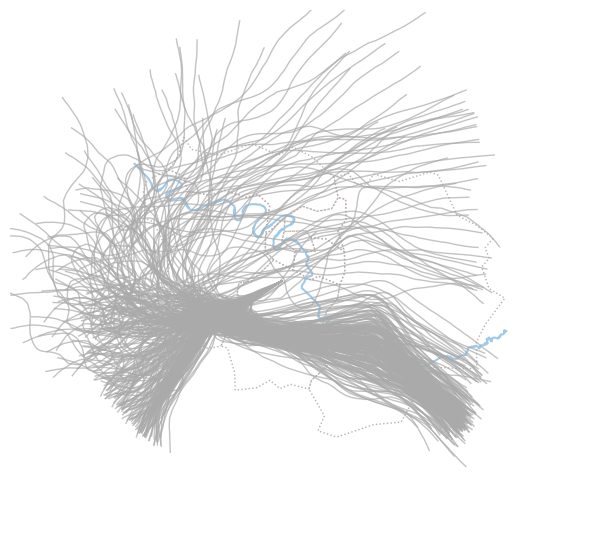

In [128]:
with plt.style.context("traffic"):
    fig, ax = plt.subplots(subplot_kw=dict(projection=Lambert93()))
    test.plot(ax, alpha=.7)

        # Background map
    ax.add_geometries(
            [seine_river], crs=PlateCarree(),
            facecolor="none", edgecolor="#9ecae9", linewidth=1.5,
        )
    paris_area.set_crs(4326).to_crs(2154).plot(
            ax=ax,
            facecolor="none", edgecolor="#bab0ac", linestyle="dotted",
        )

    ax.set_extent((0.78, 4.06, 47.7, 49.7))

KeyboardInterrupt: 

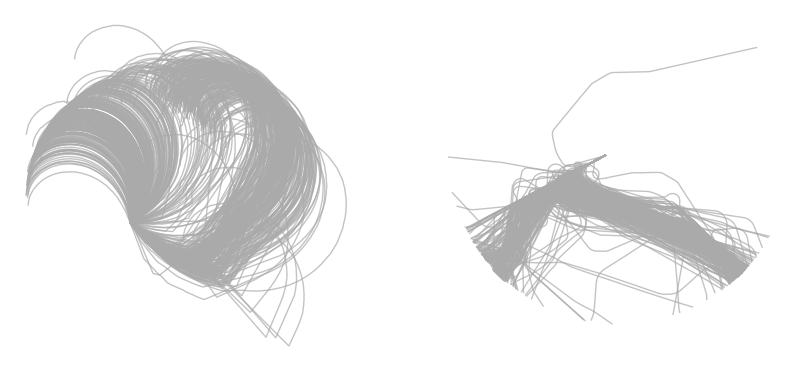

In [ ]:
with plt.style.context("traffic"):
    fig, ax = plt.subplots(1,2,subplot_kw=dict(projection=Lambert93()))
    test.plot(ax[0], alpha=.7)
    landings_orly_6[:500].plot(ax[1], alpha=.7)

    for ax_ in ax.ravel():
        # Background map
        ax_.add_geometries(
            [seine_river], crs=PlateCarree(),
            facecolor="none", edgecolor="#9ecae9", linewidth=1.5,
        )
        paris_area.set_crs(4326).to_crs(2154).plot(
            ax=ax_,
            facecolor="none", edgecolor="#bab0ac", linestyle="dotted",
        )

        ax_.set_extent((0.78, 4.06, 47.7, 49.7))

In [67]:
lat_tot = 0
long_tot = 0
n = len(test)
for flight in test:
    lat = flight.data.iloc[-1]["latitude"]
    long = flight.data.iloc[-1]["longitude"]
    lat_tot += lat
    long_tot += long

test_final = (lat_tot/n,long_tot/n)
print(test_final,mean_point)

(48.70449655912549, 2.273339242402694) (48.704496559124955, 2.2733392424026833)


#### Check altitude

In [129]:
import altair as alt

alt.data_transformers.disable_max_rows()
alt.layer(
    *(
        flight.chart().encode(
            alt.Y("altitude"),
            alt.Color("icao24"),
        )
        for flight in test
    )
)

alt.LayerChart(...)

In [91]:
alt.data_transformers.disable_max_rows()
alt.layer(
    *(
        flight.chart().encode(
            alt.Y("altitude"),
            alt.Color("icao24"),
        )
        for flight in landings_orly_6[3:4]
    )
)

alt.LayerChart(...)

### Reproduce trajectory

          track      altitude  groundspeed    timedelta
0    119.209686  26718.187500   483.191345   -84.641701
1    105.861038  26767.935547   478.362335   -92.649162
2    104.815346  26881.050781   483.877594  -124.935684
3    104.315422  26873.701172   475.694519   -83.077309
4     91.653389  26592.029297   468.863617   -84.560921
..          ...           ...          ...          ...
395   58.752846   1045.593994   136.287491  1594.601562
396   60.515926    967.493042   133.973572  1582.639893
397   59.574833    916.979004   135.233765  1583.774536
398   61.075939    754.739258   136.105759  1606.766113
399   60.196743    666.636902   138.286835  1605.893066

[400 rows x 4 columns]
0/2
1/2


alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

alt.LayerChart(...)

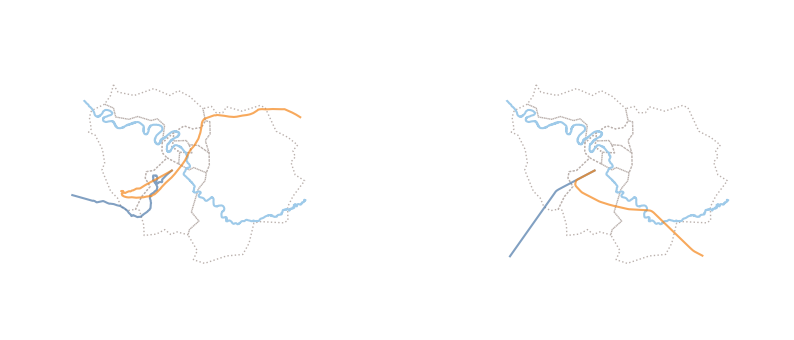

In [132]:
data,_,_ = preprocess_data(landings_orly_6[0:2])
for batch in data:
    with torch.no_grad():
        input = batch[0].to(device)
        #input = input.permute(0,2,1)

        sortie_,_,_ = model.forward(input)
        
        traffic = interpret_output(sortie_)

        with plt.style.context("traffic"):
            fig, ax = plt.subplots(1,2,subplot_kw=dict(projection=Lambert93()))
            traffic.plot(ax[0], alpha=.7)
            landings_orly_6[0:2].plot(ax[1], alpha=.7)
        
        for ax_ in ax.ravel():
            # Background map
            ax_.add_geometries(
                [seine_river], crs=PlateCarree(),
                facecolor="none", edgecolor="#9ecae9", linewidth=1.5,
            )
            paris_area.set_crs(4326).to_crs(2154).plot(
                ax=ax_,
                facecolor="none", edgecolor="#bab0ac", linestyle="dotted",
            )

            ax_.set_extent((0.78, 4.06, 47.7, 49.7))

            alt.layer(
                *(
                    flight.chart().encode(
                        alt.Y("altitude"),
                        alt.Color("icao24"),
                    )
                    for flight in traffic
                )
            ).display()

            
            alt.layer(
                *(
                    flight.chart().encode(
                        alt.Y("altitude"),
                        alt.Color("icao24"),
                    )
                    for flight in  landings_orly_6[2:4]
                )
            ).display()



### Visualisation de l'espace latent

In [75]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


latent_vectors = []


model.eval()
with torch.no_grad():
    for batch in dataloader:
        inputs = batch[0].to(device)  
        inputs =  inputs.view(inputs.size(0), -1)
        mu, log_var = model.encoder(inputs)  
        z = model.reparameterize(mu, log_var)  
        latent_vectors.append(z.cpu().numpy()) 


latent_vectors = np.concatenate(latent_vectors, axis=0) 


In [76]:
latent_vectors.shape

(7753, 32)

In [77]:
# Standardisation (optionnel mais recommandé pour PCA)
scaler = StandardScaler()
latent_scaled = scaler.fit_transform(latent_vectors)

# PCA pour réduire en 2D
pca = PCA(n_components=2)
latent_pca = pca.fit_transform(latent_scaled)

# Affichage de la variance expliquée
print("Variance expliquée par les 2 premières composantes :", pca.explained_variance_ratio_)


Variance expliquée par les 2 premières composantes : [0.03523729 0.03494395]


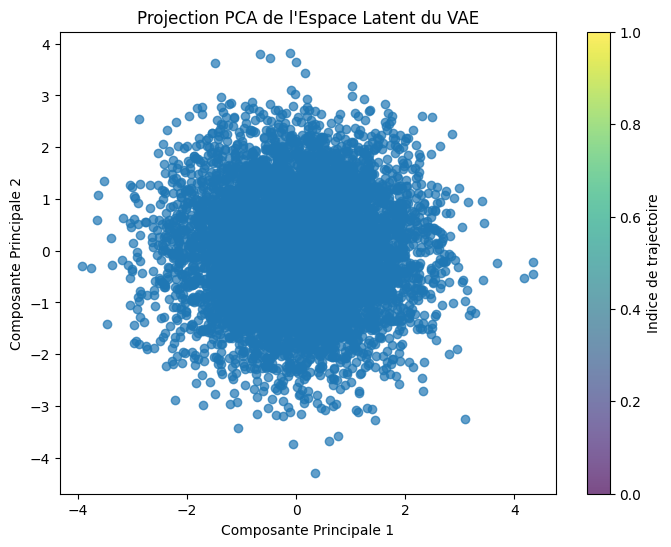

In [78]:
plt.figure(figsize=(8, 6))
plt.scatter(latent_pca[:, 0], latent_pca[:, 1], alpha=0.7, cmap='viridis')
plt.colorbar(label="Indice de trajectoire")
plt.xlabel("Composante Principale 1")
plt.ylabel("Composante Principale 2")
plt.title("Projection PCA de l'Espace Latent du VAE")
plt.show()


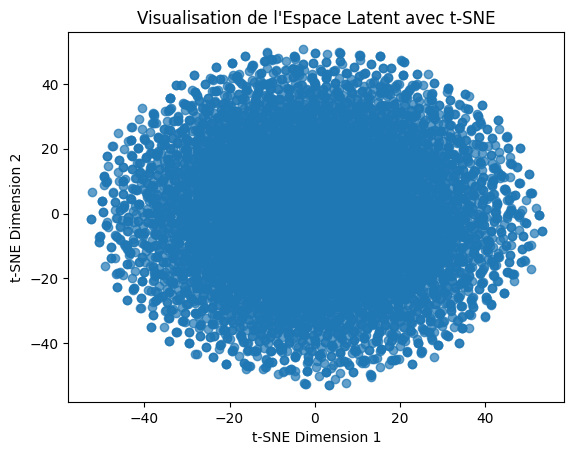

In [87]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
latent_tsne = tsne.fit_transform(latent_scaled)

plt.scatter(latent_tsne[:, 0], latent_tsne[:, 1], alpha=0.7, cmap='viridis')
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.title("Visualisation de l'Espace Latent avec t-SNE")
plt.show()